## Predição de Diagnóstico de Transtorno de Ansiedade - Trabalho Prático II
#### Inteligência Artificial - PUC Campos Lurdes - Ciência da Computação - 2024/2 
Grupo 9 - André Santos Alves, Luana Policarpo, Igor Vidal, Joäo Pedro Rosa

## Extração

#### Importação da base 

In [1]:
import pandas as pd

chunks = []
for chunk in pd.read_csv("pns2019.csv", chunksize=10000):
    chunks.append(chunk)

base = pd.concat(chunks)
display(base)
chunks = chunk = None

,V0001,V0024,UPA_PNS,V0006_PNS,V0015,V0020,V0022,V0026,V0031,V0025A,...,VDE002,VDE014,VDF002,VDF003,VDF004,VDL001,VDM001,VDP001,VDR001,VDDATA
0,11,1110011,110000016,1,1,2019,6.0,1,1,1.0,...,1.0,6.0,2098.0,350.0,2.0,NaN,NaN,NaN,NaN,20210825
1,11,1110011,110000016,1,1,2019,6.0,1,1,0.0,...,NaN,NaN,2098.0,350.0,2.0,NaN,NaN,NaN,NaN,20210825
2,11,1110011,110000016,1,1,2019,6.0,1,1,0.0,...,1.0,4.0,2098.0,350.0,2.0,NaN,NaN,NaN,NaN,20210825
3,11,1110011,110000016,1,1,2019,6.0,1,1,9.0,...,NaN,NaN,2098.0,350.0,2.0,NaN,NaN,NaN,NaN,20210825
4,11,1110011,110000016,1,1,2019,6.0,1,1,9.0,...,NaN,NaN,2098.0,350.0,2.0,NaN,NaN,NaN,NaN,20210825
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
293721,53,5310220,530044434,14,1,2019,4.0,2,1,0.0,...,1.0,1.0,13390.0,3348.0,6.0,NaN,NaN,NaN,NaN,20210825
293722,53,5310220,530044434,14,1,2019,4.0,2,1,1.0,...,NaN,NaN,13390.0,3348.0,6.0,NaN,NaN,NaN,NaN,20210825
293723,53,5310220,530044434,14,1,2019,4.0,2,1,0.0,...,1.0,7.0,13390.0,3348.0,6.0,NaN,NaN,NaN,NaN,20210825
293724,53,5310220,530044434,14,1,2019,4.0,2,1,9.0,...,NaN,NaN,13390.0,3348.0,6.0,NaN,NaN,NaN,NaN,20210825


#### Importação do dicionário de valores

In [2]:
from pns_dictionary import dictionary

dictionary

{'Módulo A - Informações do Domicílio': Module(name='Módulo A - Informações do Domicílio', columns={'A001': Column(name='Tipo do domicílio', old_name='A001', values_dict={'1': 'Casa', '2': 'Apartamento', '3': 'Habitação em casa de cômodos, cortiço ou cabeça de porco', '9': 'Ignorado'}), 'A002010': Column(name='Qual é o material que predomina na construção das paredes externas deste domicílio?', old_name='A002010', values_dict={'1': 'Alvenaria com revestimento ou taipa revestida', '2': 'Alvenaria sem revestimento', '3': 'Taipa sem revestimento', '4': 'Madeira apropriada para construção (aparelhada)', '5': 'Madeira aproveitada', '6': 'Outro material', '9': 'Ignorado'}), 'A003010': Column(name='Material predominante na cobertura (telhado) do domicílio', old_name='A003010', values_dict={'1': 'Telha sem laje de concreto', '2': 'Telha com laje de concreto', '3': 'Somente laje de concreto', '4': 'Madeira apropriada para construção (aparelhada)', '5': 'Zinco, alumínio ou chapa metálica', '6': 

## Transformação

### Redução da base para colunas de interesse

#### Características do residente

In [3]:
resident_df = (
    dictionary["Módulo C - Características gerais dos moradores"]
    .get_module_dataframe(base)
    .loc[
        :,
        [
            "Cor ou raça",
            "Sexo",
            "Qual é o estado civil de ___?",
        ],
    ]
)

resident_df

,Cor ou raça,Sexo,Qual é o estado civil de ___?
0,Branca,Mulher,Casado(a)
1,Parda,Homem,Casado(a)
2,Preta,Homem,Solteiro(a)
3,Preta,Homem,NaN
4,Parda,Mulher,NaN
...,...,...,...
293721,Preta,Mulher,Solteiro(a)
293722,Parda,Homem,Viúvo(a)
293723,Branca,Homem,Solteiro(a)
293724,Parda,Mulher,Solteiro(a)


#### Trabalho

In [4]:
work_df: pd.DataFrame = (
    dictionary[
        "Módulo E - Características de trabalho das pessoas de 14 anos ou mais de idade"
    ]
    .get_module_dataframe(base)
    .drop(
        [
            "Na semana de ___ a ___ (semana de referência), ___ tinha algum trabalho remunerado do qual estava temporariamente afastado",
            "Na semana de ___ a ___ (semana de referência), por que motivo ___ estava afastado desse trabalho",
            "A doença ou acidente foi relacionado ao trabalho?",
            "Em ___ /___ /___ (último dia da semana de referência), fazia quanto tempo que ___ estava afastado desse trabalho",
            "Tempo que estava afastado (De 1 mês a menos de 1 ano)",
            "Tempo que estava afastado (De 1 ano a menos de 2 anos)",
            "Tempo que estava afastado (De 2 anos a 98 anos)",
            "Trabalhador não remunerado em ajuda a membro do domicílio ou parente",
            "Nesse trabalho, ___era servidor público estatutário (federal, estadual ou municipal)",
            "Qual era a principal atividade desse negócio/empresa",
            "...recebia/fazia normalmente nesse trabalho rendimento/retirada em dinheiro?",
            "Qual era o rendimento bruto mensal ou retirada que ___ fazia normalmente nesse trabalho?(valor em dinheiro)",
            "...recebia/fazia normalmente nesse trabalho rendimento/retirada em produtos ou mercadorias?",
            "Qual era o rendimento bruto mensal ou retirada que ___ fazia normalmente nesse trabalho?(valor estimado em produtos ou mercadorias)",
            "...recebia/fazia normalmente nesse trabalho rendimento/retirada somente em benefícios ?",
            "Quantas horas ___ trabalhava normalmente, por semana, nesse trabalho?",
            "...recebia/fazia normalmente nesse(s) outro(s) trabalho(s) rendimento/retirada em dinheiro?",
            "Qual era o rendimento bruto mensal ou retirada que ___ fazia normalmente nesse(s) outro(s) trabalho(s)?(valor em dinheiro)",
            "...recebia/fazia normalmente nesse(s) outro(s) trabalho(s) rendimento/retirada em produtos ou mercadorias?",
            "Qual era o rendimento bruto mensal ou retirada que ___ fazia normalmente nesse(s) outro(s) trabalho(s)?(valor estimado em produtos ou mercadorias)",
            "...recebia/fazia normalmente nesse(s) outro(s) trabalho(s) rendimento/retirada somente em benefícios ?",
            "Quantas horas ___ trabalhava normalmente, por semana, nesses outros trabalhos?",
            "No período de ___ a ___ (período de referência de 30 dias), qual foi a principal providência que ___ tomou para conseguir trabalho?",
            "Quanto tempo depois de __/__/__ (último dia da semana de referência) ___ irá começar esse trabalho que conseguiu?",
            "Número de meses para começar o trabalho que conseguiu.",
            "Até o dia ___ (último dia da semana de referência), fazia quanto tempo que___ estava sem qualquer trabalho e tentando conseguir trabalho?",
            "fazia quanto tempo que vinha procurando trabalho (de 1 mês a menos de 1 ano)",
            "fazia quanto tempo que vinha procurando trabalho (de 1 ano a menos de 2 anos)",
            "fazia quanto tempo vinha procurando trabalho (2 anos ou mais)",
            "Se tivesse conseguido um trabalho ___ poderia ter começado a trabalhar na semana de___ a ___ (semana de referência)",
            ". Na semana de___a___ (semana de referência), ___ qual foi o total de horas que dedicou às atividades de cuidados de pessoas e/ou afazeres domésticos?",
            "Qual era a ocupação (cargo ou função) que ___ tinha nesse trabalho",
            "Informante do Módulo E",
        ],
        axis=1,
    )
)

work_df

,"Na semana de___ a___ (semana de referência), ___ trabalhou ou estagiou, durante pelo menos uma hora, em alguma atividade remunerada em dinheiro","Na semana de ___a___ (semana de referência), ___ trabalhou ou estagiou, durante pelo menos uma hora, em alguma atividade remunerada em produtos, mercadorias, moradia, alimentação, treinamento ou aprendizado etc","Na semana de ___ a ___ (semana de referência), ___ fez algum bico ou trabalhou em alguma atividade ocasional remunerada durante pelo menos 1 hora","Na semana de ___ a ___ (semana de referência), ___ ajudou durante pelo menos 1 hora, sem receber pagamento, no trabalho remunerado de algum morador do domicílio ou de parente",Quantos trabalhos ___tinha na semana de ___ a ___,"Nesse trabalho, ___ era","Nesse trabalho, ___tinha carteira de trabalho assinada","No período de ___ a ___ (período de referência de 30 dias), ___ tomou alguma providência para conseguir trabalho, seja um emprego ou um negócio próprio?",Qual foi o principal motivo de ___ não ter tomado providência para conseguir trabalho no período de ___ a ___ (período de referência de 30 dias)?,"No período de ___ a ___ (período de referência de 358 dias), ___ trabalhou, por pelo menos 1 hora?",...,"Na semana de ___ a ___ (semana de referência), ___ cuidou de parentes que não moravam neste domicílio e que precisavam de cuidados (crianças, idosos, enfermos ou pessoas com necessidades especiais)?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: preparar ou servir alimentos, arrumar a mesa ou lavar as louças?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: cuidar da limpeza ou manutenção de roupas e sapatos/","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: fazer pequenos reparos ou manutenção do domicílio, do automóvel, de eletrodomésticos ou outros equipamentos?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Limpar ou arrumar o domicílio, a garagem, o quintal ou o jardim?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Cuidar da organização do domicílio (pagar contas, contratar serviços, orientar empregados etc.)?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Fazer compras ou pesquisar preços de bens para o domicílio?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Cuidar dos animais domésticos?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Outras tarefas domésticas?",". Na semana de___a___ (semana de referência), ___fez alguma tarefa doméstica em domicílio de parente?"
0,Sim,NaN,NaN,NaN,Um,Conta própria,NaN,NaN,NaN,NaN,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não
1,Não,Não,Não,Não,NaN,NaN,NaN,Não,Não desejava trabalhar,Não,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não
2,Sim,NaN,NaN,NaN,Um,Empregado do setor privado,Sim,NaN,NaN,NaN,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
293721,Sim,NaN,NaN,NaN,Um,Conta própria,NaN,NaN,NaN,NaN,...,Não,Sim,Sim,Não,Sim,Sim,Sim,Sim,Não,Não
293722,Não,Não,Não,Não,NaN,NaN,NaN,Não,Não desejava trabalhar,Não,...,Não,Sim,Sim,Não,Sim,Sim,Sim,Sim,Não,Não
293723,Sim,NaN,NaN,NaN,Um,Empregado do setor público (inclusive empresas...,Não,NaN,NaN,NaN,...,Não,Sim,Sim,Não,Sim,Sim,Sim,Sim,Não,Não
293724,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### Diagnóstico de doença mental

In [5]:
health_df: pd.DataFrame = dictionary[
    "Módulo Q - Doenças crônicas"
].get_module_dataframe(base)[
    "Algum médico ou profissional de saúde (como psiquiatra ou psicólogo) já lhe deu o diagnóstico de outra doença mental, como transtorno de ansiedade, síndrome do pânico, esquizofrenia, transtorno bipolar, psicose ou TOC (Transtorno Obsessivo Compulsivo) etc?"
]

health_df

O(A) Sr(a) pagou algum valor pelos medicamentos?
Esse atendimento foi feito pelo SUS?
Na última consulta, o médico que o(a) atendeu era o mesmo das consultas anteriores?
Na última consulta, o médico viu os exames das consultas passadas?
Orientações para manter uma alimentação saudável
Manter o peso adequado
Praticar atividade física regular
Não fumar
Não beber em excesso
Fazer uso de acupuntura, plantas medicinais e fitoterapia, homeopatia, meditação, yoga, tai chi chuan, liang gong ou alguma outra prática integrativa e complementar
Foi pedido exame de urina?
O(A) Sr(a) pagou algum valor por esse atendimento?
Esse atendimento foi feito pelo SUS?
Na última consulta, o médico que o(a) atendeu era o mesmo das consultas anteriores?
Na última consulta, o médico viu os exames das consultas passadas?
Orientações para manter uma alimentação saudável
Manter o peso adequado
Praticar atividade física regular
Não fumar
Não beber em excesso
Fazer uso de acupuntura, plantas medicinais e fitoterapia,

0         Não
1         NaN
2         NaN
3         NaN
4         NaN
         ... 
293721    NaN
293722    NaN
293723    NaN
293724    NaN
293725    NaN
Name: Algum médico ou profissional de saúde (como psiquiatra ou psicólogo) já lhe deu o diagnóstico de outra doença mental, como transtorno de ansiedade, síndrome do pânico, esquizofrenia, transtorno bipolar, psicose ou TOC (Transtorno Obsessivo Compulsivo) etc?, Length: 293726, dtype: object

#### Criação da base tratada

In [6]:
base = None
treated_df = pd.concat((resident_df, work_df, health_df), axis=1).dropna(
    subset=[
        "Algum médico ou profissional de saúde (como psiquiatra ou psicólogo) já lhe deu o diagnóstico de outra doença mental, como transtorno de ansiedade, síndrome do pânico, esquizofrenia, transtorno bipolar, psicose ou TOC (Transtorno Obsessivo Compulsivo) etc?"
    ]
)
resident_df = work_df = health_df = dictionary = None

treated_df

,Cor ou raça,Sexo,Qual é o estado civil de ___?,"Na semana de___ a___ (semana de referência), ___ trabalhou ou estagiou, durante pelo menos uma hora, em alguma atividade remunerada em dinheiro","Na semana de ___a___ (semana de referência), ___ trabalhou ou estagiou, durante pelo menos uma hora, em alguma atividade remunerada em produtos, mercadorias, moradia, alimentação, treinamento ou aprendizado etc","Na semana de ___ a ___ (semana de referência), ___ fez algum bico ou trabalhou em alguma atividade ocasional remunerada durante pelo menos 1 hora","Na semana de ___ a ___ (semana de referência), ___ ajudou durante pelo menos 1 hora, sem receber pagamento, no trabalho remunerado de algum morador do domicílio ou de parente",Quantos trabalhos ___tinha na semana de ___ a ___,"Nesse trabalho, ___ era","Nesse trabalho, ___tinha carteira de trabalho assinada",...,"Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: preparar ou servir alimentos, arrumar a mesa ou lavar as louças?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: cuidar da limpeza ou manutenção de roupas e sapatos/","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: fazer pequenos reparos ou manutenção do domicílio, do automóvel, de eletrodomésticos ou outros equipamentos?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Limpar ou arrumar o domicílio, a garagem, o quintal ou o jardim?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Cuidar da organização do domicílio (pagar contas, contratar serviços, orientar empregados etc.)?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Fazer compras ou pesquisar preços de bens para o domicílio?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Cuidar dos animais domésticos?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Outras tarefas domésticas?",". Na semana de___a___ (semana de referência), ___fez alguma tarefa doméstica em domicílio de parente?","Algum médico ou profissional de saúde (como psiquiatra ou psicólogo) já lhe deu o diagnóstico de outra doença mental, como transtorno de ansiedade, síndrome do pânico, esquizofrenia, transtorno bipolar, psicose ou TOC (Transtorno Obsessivo Compulsivo) etc?"
0,Branca,Mulher,Casado(a),Sim,NaN,NaN,NaN,Um,Conta própria,NaN,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não,Não
9,Parda,Mulher,Solteiro(a),Sim,NaN,NaN,NaN,Um,Conta própria,NaN,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não,Não
10,Preta,Mulher,Solteiro(a),Sim,NaN,NaN,NaN,Um,Empregado do setor privado,Sim,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não,Não
18,Preta,Mulher,Viúvo(a),Sim,NaN,NaN,NaN,Um,Empregado do setor privado,Não,...,Sim,Sim,Não,Sim,Sim,Sim,Sim,Não,Sim,Não
19,Parda,Mulher,Solteiro(a),Não,Não,Não,Não,NaN,NaN,NaN,...,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não,Não,Não
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
293709,Parda,Mulher,Casado(a),Sim,NaN,NaN,NaN,Um,Empregado do setor privado,Sim,...,Sim,Sim,Não,Sim,Sim,Sim,Sim,Não,Não,Não
293712,Parda,Homem,Divorciado(a) ou desquitado(a) ou separado(a) ...,Sim,NaN,NaN,NaN,Um,Empregado do setor privado,Sim,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não,Não
293713,Parda,Mulher,Casado(a),Não,Não,Não,Não,NaN,NaN,NaN,...,Sim,Sim,Não,Sim,Sim,Sim,Sim,Não,Não,Não
293718,Parda,Homem,Casado(a),Sim,NaN,NaN,NaN,Um,Conta própria,NaN,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não,Sim


#### Preenchendo valores nulos

In [7]:
columns = (
    "Na semana de ___a___ (semana de referência), ___ trabalhou ou estagiou, durante pelo menos uma hora, em alguma atividade remunerada em produtos, mercadorias, moradia, alimentação, treinamento ou aprendizado etc",
    "Na semana de ___ a ___ (semana de referência), ___ fez algum bico ou trabalhou em alguma atividade ocasional remunerada durante pelo menos 1 hora",
    "Na semana de ___ a ___ (semana de referência), ___ ajudou durante pelo menos 1 hora, sem receber pagamento, no trabalho remunerado de algum morador do domicílio ou de parente",
)

for column in columns:
    treated_df.loc[:, column] = treated_df[column].fillna("Não")

columns = (
    "Nesse trabalho, ___ era",
    "Nesse trabalho, ___tinha carteira de trabalho assinada",
    "No período de ___ a ___ (período de referência de 30 dias), ___ tomou alguma providência para conseguir trabalho, seja um emprego ou um negócio próprio?",
    "Qual foi o principal motivo de ___ não ter tomado providência para conseguir trabalho no período de ___ a ___ (período de referência de 30 dias)?",
    "No período de ___ a ___ (período de referência de 358 dias), ___ trabalhou, por pelo menos 1 hora?",
)

for column in columns:
    treated_df.loc[:, column] = treated_df[column].fillna("Não se aplica")

column = "Quantos trabalhos ___tinha na semana de ___ a ___"
treated_df.loc[:, column] = treated_df[column].fillna(0)

treated_df

,Cor ou raça,Sexo,Qual é o estado civil de ___?,"Na semana de___ a___ (semana de referência), ___ trabalhou ou estagiou, durante pelo menos uma hora, em alguma atividade remunerada em dinheiro","Na semana de ___a___ (semana de referência), ___ trabalhou ou estagiou, durante pelo menos uma hora, em alguma atividade remunerada em produtos, mercadorias, moradia, alimentação, treinamento ou aprendizado etc","Na semana de ___ a ___ (semana de referência), ___ fez algum bico ou trabalhou em alguma atividade ocasional remunerada durante pelo menos 1 hora","Na semana de ___ a ___ (semana de referência), ___ ajudou durante pelo menos 1 hora, sem receber pagamento, no trabalho remunerado de algum morador do domicílio ou de parente",Quantos trabalhos ___tinha na semana de ___ a ___,"Nesse trabalho, ___ era","Nesse trabalho, ___tinha carteira de trabalho assinada",...,"Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: preparar ou servir alimentos, arrumar a mesa ou lavar as louças?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: cuidar da limpeza ou manutenção de roupas e sapatos/","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: fazer pequenos reparos ou manutenção do domicílio, do automóvel, de eletrodomésticos ou outros equipamentos?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Limpar ou arrumar o domicílio, a garagem, o quintal ou o jardim?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Cuidar da organização do domicílio (pagar contas, contratar serviços, orientar empregados etc.)?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Fazer compras ou pesquisar preços de bens para o domicílio?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Cuidar dos animais domésticos?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Outras tarefas domésticas?",". Na semana de___a___ (semana de referência), ___fez alguma tarefa doméstica em domicílio de parente?","Algum médico ou profissional de saúde (como psiquiatra ou psicólogo) já lhe deu o diagnóstico de outra doença mental, como transtorno de ansiedade, síndrome do pânico, esquizofrenia, transtorno bipolar, psicose ou TOC (Transtorno Obsessivo Compulsivo) etc?"
0,Branca,Mulher,Casado(a),Sim,Não,Não,Não,Um,Conta própria,Não se aplica,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não,Não
9,Parda,Mulher,Solteiro(a),Sim,Não,Não,Não,Um,Conta própria,Não se aplica,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não,Não
10,Preta,Mulher,Solteiro(a),Sim,Não,Não,Não,Um,Empregado do setor privado,Sim,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não,Não
18,Preta,Mulher,Viúvo(a),Sim,Não,Não,Não,Um,Empregado do setor privado,Não,...,Sim,Sim,Não,Sim,Sim,Sim,Sim,Não,Sim,Não
19,Parda,Mulher,Solteiro(a),Não,Não,Não,Não,0,Não se aplica,Não se aplica,...,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não,Não,Não
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
293709,Parda,Mulher,Casado(a),Sim,Não,Não,Não,Um,Empregado do setor privado,Sim,...,Sim,Sim,Não,Sim,Sim,Sim,Sim,Não,Não,Não
293712,Parda,Homem,Divorciado(a) ou desquitado(a) ou separado(a) ...,Sim,Não,Não,Não,Um,Empregado do setor privado,Sim,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não,Não
293713,Parda,Mulher,Casado(a),Não,Não,Não,Não,0,Não se aplica,Não se aplica,...,Sim,Sim,Não,Sim,Sim,Sim,Sim,Não,Não,Não
293718,Parda,Homem,Casado(a),Sim,Não,Não,Não,Um,Conta própria,Não se aplica,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não,Sim


#### Remoção de linhas vazias
Como foram encontradas poucas linhas sem informação, optamos pela remoção.

In [8]:
treated_df = treated_df.dropna()
treated_df

,Cor ou raça,Sexo,Qual é o estado civil de ___?,"Na semana de___ a___ (semana de referência), ___ trabalhou ou estagiou, durante pelo menos uma hora, em alguma atividade remunerada em dinheiro","Na semana de ___a___ (semana de referência), ___ trabalhou ou estagiou, durante pelo menos uma hora, em alguma atividade remunerada em produtos, mercadorias, moradia, alimentação, treinamento ou aprendizado etc","Na semana de ___ a ___ (semana de referência), ___ fez algum bico ou trabalhou em alguma atividade ocasional remunerada durante pelo menos 1 hora","Na semana de ___ a ___ (semana de referência), ___ ajudou durante pelo menos 1 hora, sem receber pagamento, no trabalho remunerado de algum morador do domicílio ou de parente",Quantos trabalhos ___tinha na semana de ___ a ___,"Nesse trabalho, ___ era","Nesse trabalho, ___tinha carteira de trabalho assinada",...,"Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: preparar ou servir alimentos, arrumar a mesa ou lavar as louças?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: cuidar da limpeza ou manutenção de roupas e sapatos/","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: fazer pequenos reparos ou manutenção do domicílio, do automóvel, de eletrodomésticos ou outros equipamentos?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Limpar ou arrumar o domicílio, a garagem, o quintal ou o jardim?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Cuidar da organização do domicílio (pagar contas, contratar serviços, orientar empregados etc.)?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Fazer compras ou pesquisar preços de bens para o domicílio?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Cuidar dos animais domésticos?","Na semana de___a___ (semana de referência), ___fez tarefas domésticas para o próprio domicílio, tais como: Outras tarefas domésticas?",". Na semana de___a___ (semana de referência), ___fez alguma tarefa doméstica em domicílio de parente?","Algum médico ou profissional de saúde (como psiquiatra ou psicólogo) já lhe deu o diagnóstico de outra doença mental, como transtorno de ansiedade, síndrome do pânico, esquizofrenia, transtorno bipolar, psicose ou TOC (Transtorno Obsessivo Compulsivo) etc?"
0,Branca,Mulher,Casado(a),Sim,Não,Não,Não,Um,Conta própria,Não se aplica,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não,Não
9,Parda,Mulher,Solteiro(a),Sim,Não,Não,Não,Um,Conta própria,Não se aplica,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não,Não
10,Preta,Mulher,Solteiro(a),Sim,Não,Não,Não,Um,Empregado do setor privado,Sim,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não,Não
19,Parda,Mulher,Solteiro(a),Não,Não,Não,Não,0,Não se aplica,Não se aplica,...,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não,Não,Não
22,Parda,Mulher,Casado(a),Sim,Não,Não,Não,Um,Empregado do setor privado,Não,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Sim,Não
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
293702,Parda,Mulher,Solteiro(a),Não,Não,Não,Não,0,Não se aplica,Não se aplica,...,Sim,Sim,Não,Sim,Sim,Sim,Sim,Não,Não,Não
293709,Parda,Mulher,Casado(a),Sim,Não,Não,Não,Um,Empregado do setor privado,Sim,...,Sim,Sim,Não,Sim,Sim,Sim,Sim,Não,Não,Não
293712,Parda,Homem,Divorciado(a) ou desquitado(a) ou separado(a) ...,Sim,Não,Não,Não,Um,Empregado do setor privado,Sim,...,Sim,Sim,Sim,Sim,Sim,Sim,Sim,Não,Não,Não
293713,Parda,Mulher,Casado(a),Não,Não,Não,Não,0,Não se aplica,Não se aplica,...,Sim,Sim,Não,Sim,Sim,Sim,Sim,Não,Não,Não


### Encoding

In [9]:
target_column = "Algum médico ou profissional de saúde (como psiquiatra ou psicólogo) já lhe deu o diagnóstico de outra doença mental, como transtorno de ansiedade, síndrome do pânico, esquizofrenia, transtorno bipolar, psicose ou TOC (Transtorno Obsessivo Compulsivo) etc?"

one_hot_columns = [
    "Cor ou raça",
    "Sexo",
    "Qual é o estado civil de ___?",
    "Nesse trabalho, ___ era",
    "Nesse trabalho, ___tinha carteira de trabalho assinada",
    "No período de ___ a ___ (período de referência de 30 dias), ___ tomou alguma providência para conseguir trabalho, seja um emprego ou um negócio próprio?",
    "Qual foi o principal motivo de ___ não ter tomado providência para conseguir trabalho no período de ___ a ___ (período de referência de 30 dias)?",
    "No período de ___ a ___ (período de referência de 358 dias), ___ trabalhou, por pelo menos 1 hora?",
]

boolean_columns = list(
    filter(lambda c: c not in one_hot_columns and c != target_column, treated_df.columns.values)
)
treated_df = pd.get_dummies(treated_df, columns=one_hot_columns)
treated_df

,"Na semana de___ a___ (semana de referência), ___ trabalhou ou estagiou, durante pelo menos uma hora, em alguma atividade remunerada em dinheiro","Na semana de ___a___ (semana de referência), ___ trabalhou ou estagiou, durante pelo menos uma hora, em alguma atividade remunerada em produtos, mercadorias, moradia, alimentação, treinamento ou aprendizado etc","Na semana de ___ a ___ (semana de referência), ___ fez algum bico ou trabalhou em alguma atividade ocasional remunerada durante pelo menos 1 hora","Na semana de ___ a ___ (semana de referência), ___ ajudou durante pelo menos 1 hora, sem receber pagamento, no trabalho remunerado de algum morador do domicílio ou de parente",Quantos trabalhos ___tinha na semana de ___ a ___,"Na semana de ___a___ (semana de referência), ___ realizou tarefas de cuidados de moradores deste domicílio que eram crianças, idosos, enfermos ou pessoas com necessidades especiais, tais como: Auxiliar nos cuidados pessoais (alimentar, vestir, pentear, dar remédio, dar banho, colocar para dormir)","Na semana de ___a___ (semana de referência), ___ realizou tarefas de cuidados de moradores deste domicílio que eram crianças, idosos, enfermos ou pessoas com necessidades especiais, tais como: Auxiliar em atividades educacionais","Na semana de ___a___ (semana de referência), ___ realizou tarefas de cuidados de moradores deste domicílio que eram crianças, idosos, enfermos ou pessoas com necessidades especiais, tais como: Ler, jogar ou brincar","Na semana de ___a___ (semana de referência), ___ realizou tarefas de cuidados de moradores deste domicílio que eram crianças, idosos, enfermos ou pessoas com necessidades especiais, tais como: Monitorar ou fazer companhia dentro do domicílio","Na semana de ___a___ (semana de referência), ___ realizou tarefas de cuidados de moradores deste domicílio que eram crianças, idosos, enfermos ou pessoas com necessidades especiais, tais como: Transportar ou acompanhar para escola, médico, exames, parque, praça, atividades sociais, culturais, esportivas ou religiosas",...,Qual foi o principal motivo de ___ não ter tomado providência para conseguir trabalho no período de ___ a ___ (período de referência de 30 dias)?_Não desejava trabalhar,Qual foi o principal motivo de ___ não ter tomado providência para conseguir trabalho no período de ___ a ___ (período de referência de 30 dias)?_Não havia trabalho na localidade,Qual foi o principal motivo de ___ não ter tomado providência para conseguir trabalho no período de ___ a ___ (período de referência de 30 dias)?_Não se aplica,Qual foi o principal motivo de ___ não ter tomado providência para conseguir trabalho no período de ___ a ___ (período de referência de 30 dias)?_Não tinha experiência profissional ou qualificação,Qual foi o principal motivo de ___ não ter tomado providência para conseguir trabalho no período de ___ a ___ (período de referência de 30 dias)?_Outro motivo,Qual foi o principal motivo de ___ não ter tomado providência para conseguir trabalho no período de ___ a ___ (período de referência de 30 dias)?_Por problema de saúde ou gravidez,"Qual foi o principal motivo de ___ não ter tomado providência para conseguir trabalho no período de ___ a ___ (período de referência de 30 dias)?_Tinha que cuidar dos afazeres domésticos, do(s) filho(s) ou de outro(s) parente(s)","No período de ___ a ___ (período de referência de 358 dias), ___ trabalhou, por pelo menos 1 hora?_Não","No período de ___ a ___ (período de referência de 358 dias), ___ trabalhou, por pelo menos 1 hora?_Não se aplica","No período de ___ a ___ (período de referência de 358 dias), ___ trabalhou, por pelo menos 1 hora?_Sim"
0,Sim,Não,Não,Não,Um,Sim,Sim,Sim,Sim,Sim,...,False,False,True,False,False,False,False,False,True,False
9,Sim,Não,Não,Não,Um,Não,Não,Não,Não,Não,...,False,False,True,False,False,False,False,False,True,False
10,Sim,Não,Não,Não,Um,Sim,Sim,Sim,Sim,Sim,...,False,False,True,False,False,False,False,False,True,False
19,Não,Não,Não,Não,0,Sim,Não,Sim,Sim,S

In [10]:
from typing import Callable

parse_columns: Callable[[pd.DataFrame], bool] = lambda c: c.apply(lambda v: v == "Sim")

treated_df.loc[:, boolean_columns] = treated_df[boolean_columns].apply(parse_columns)
treated_df

,"Na semana de___ a___ (semana de referência), ___ trabalhou ou estagiou, durante pelo menos uma hora, em alguma atividade remunerada em dinheiro","Na semana de ___a___ (semana de referência), ___ trabalhou ou estagiou, durante pelo menos uma hora, em alguma atividade remunerada em produtos, mercadorias, moradia, alimentação, treinamento ou aprendizado etc","Na semana de ___ a ___ (semana de referência), ___ fez algum bico ou trabalhou em alguma atividade ocasional remunerada durante pelo menos 1 hora","Na semana de ___ a ___ (semana de referência), ___ ajudou durante pelo menos 1 hora, sem receber pagamento, no trabalho remunerado de algum morador do domicílio ou de parente",Quantos trabalhos ___tinha na semana de ___ a ___,"Na semana de ___a___ (semana de referência), ___ realizou tarefas de cuidados de moradores deste domicílio que eram crianças, idosos, enfermos ou pessoas com necessidades especiais, tais como: Auxiliar nos cuidados pessoais (alimentar, vestir, pentear, dar remédio, dar banho, colocar para dormir)","Na semana de ___a___ (semana de referência), ___ realizou tarefas de cuidados de moradores deste domicílio que eram crianças, idosos, enfermos ou pessoas com necessidades especiais, tais como: Auxiliar em atividades educacionais","Na semana de ___a___ (semana de referência), ___ realizou tarefas de cuidados de moradores deste domicílio que eram crianças, idosos, enfermos ou pessoas com necessidades especiais, tais como: Ler, jogar ou brincar","Na semana de ___a___ (semana de referência), ___ realizou tarefas de cuidados de moradores deste domicílio que eram crianças, idosos, enfermos ou pessoas com necessidades especiais, tais como: Monitorar ou fazer companhia dentro do domicílio","Na semana de ___a___ (semana de referência), ___ realizou tarefas de cuidados de moradores deste domicílio que eram crianças, idosos, enfermos ou pessoas com necessidades especiais, tais como: Transportar ou acompanhar para escola, médico, exames, parque, praça, atividades sociais, culturais, esportivas ou religiosas",...,Qual foi o principal motivo de ___ não ter tomado providência para conseguir trabalho no período de ___ a ___ (período de referência de 30 dias)?_Não desejava trabalhar,Qual foi o principal motivo de ___ não ter tomado providência para conseguir trabalho no período de ___ a ___ (período de referência de 30 dias)?_Não havia trabalho na localidade,Qual foi o principal motivo de ___ não ter tomado providência para conseguir trabalho no período de ___ a ___ (período de referência de 30 dias)?_Não se aplica,Qual foi o principal motivo de ___ não ter tomado providência para conseguir trabalho no período de ___ a ___ (período de referência de 30 dias)?_Não tinha experiência profissional ou qualificação,Qual foi o principal motivo de ___ não ter tomado providência para conseguir trabalho no período de ___ a ___ (período de referência de 30 dias)?_Outro motivo,Qual foi o principal motivo de ___ não ter tomado providência para conseguir trabalho no período de ___ a ___ (período de referência de 30 dias)?_Por problema de saúde ou gravidez,"Qual foi o principal motivo de ___ não ter tomado providência para conseguir trabalho no período de ___ a ___ (período de referência de 30 dias)?_Tinha que cuidar dos afazeres domésticos, do(s) filho(s) ou de outro(s) parente(s)","No período de ___ a ___ (período de referência de 358 dias), ___ trabalhou, por pelo menos 1 hora?_Não","No período de ___ a ___ (período de referência de 358 dias), ___ trabalhou, por pelo menos 1 hora?_Não se aplica","No período de ___ a ___ (período de referência de 358 dias), ___ trabalhou, por pelo menos 1 hora?_Sim"
0,True,False,False,False,False,True,True,True,True,True,...,False,False,True,False,False,False,False,False,True,False
9,True,False,False,False,False,False,False,False,False,False,...,False,False,True,False,False,False,False,False,True,False
10,True,False,False,False,False,True,True,True,True,True,...,False,False,True,False,False,False,False,False

## Processamento

#### Separação da base em teste e treinamento com oversample

In [11]:
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X = treated_df.drop(target_column, axis=1)
y = treated_df[target_column]

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42
)

smote = SMOTE()
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

### Árvore de decisão

##

In [12]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

param_grid = {
    "criterion": ["gini", "entropy"],
    "max_depth": [None, 5, 10, 15],
    "min_samples_split": [2, 5, 10],
    "min_samples_leaf": [1, 2, 5],
}

model = DecisionTreeClassifier()
grid_search = GridSearchCV(model, param_grid=param_grid, cv=5, verbose=2)

grid_search.fit(X_resampled, y_resampled)

Fitting 5 folds for each of 72 candidates, totalling 360 fits
[CV] END criterion=gini, max_depth=None, min_samples_leaf=1, min_samples_split=2; total time=   0.7s
[CV] END criterion=gini, max_depth=None, min_samples_leaf=1, min_samples_split=2; total time=   0.7s
[CV] END criterion=gini, max_depth=None, min_samples_leaf=1, min_samples_split=2; total time=   0.7s
[CV] END criterion=gini, max_depth=None, min_samples_leaf=1, min_samples_split=2; total time=   0.7s
[CV] END criterion=gini, max_depth=None, min_samples_leaf=1, min_samples_split=2; total time=   0.7s
[CV] END criterion=gini, max_depth=None, min_samples_leaf=1, min_samples_split=5; total time=   0.7s
[CV] END criterion=gini, max_depth=None, min_samples_leaf=1, min_samples_split=5; total time=   0.7s
[CV] END criterion=gini, max_depth=None, min_samples_leaf=1, min_samples_split=5; total time=   0.8s
[CV] END criterion=gini, max_depth=None, min_samples_leaf=1, min_samples_split=5; total time=   0.7s
[CV] END criterion=gini, max_

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [None, 5, 10, 15],
                         'min_samples_leaf': [1, 2, 5],
                         'min_samples_split': [2, 5, 10]},
             verbose=2)

In [13]:
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree

best_tree = grid_search.best_estimator_

plt.figure(figsize=(500,125))
plot_tree(
    best_tree,
    feature_names=X.columns,
    class_names=y.unique().astype(str),
    filled=True,
    rounded=True,
    fontsize=24,
    proportion=True,
)
plt.show()

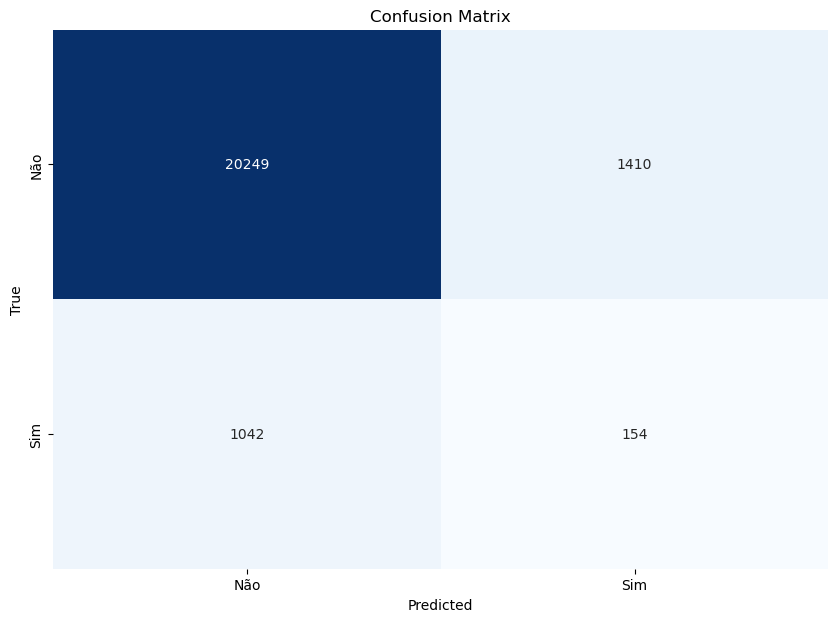

In [14]:
import seaborn as sns
from sklearn.metrics import confusion_matrix


y_pred = best_tree.predict(X_test)

cm = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(10, 7))
sns.heatmap(
    cm,
    annot=True,
    fmt="d",
    cmap="Blues",
    cbar=False,
    xticklabels=best_tree.classes_,
    yticklabels=best_tree.classes_,
)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.show()

In [15]:
print(grid_search.score(X_test, y_test))

0.8927149420258149


### Naïve Bayes

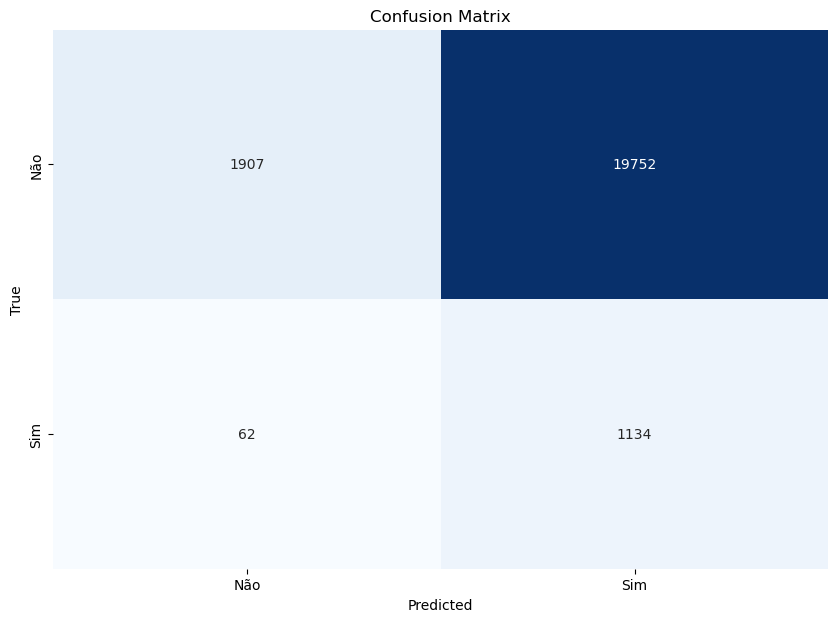

0.13305622402100198


In [16]:
from sklearn.naive_bayes import GaussianNB

model = GaussianNB()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

cm = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(10, 7))
sns.heatmap(
    cm,
    annot=True,
    fmt="d",
    cmap="Blues",
    cbar=False,
    xticklabels=model.classes_,
    yticklabels=model.classes_,
)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.show()

print(model.score(X_test, y_test))

#### Random Forest

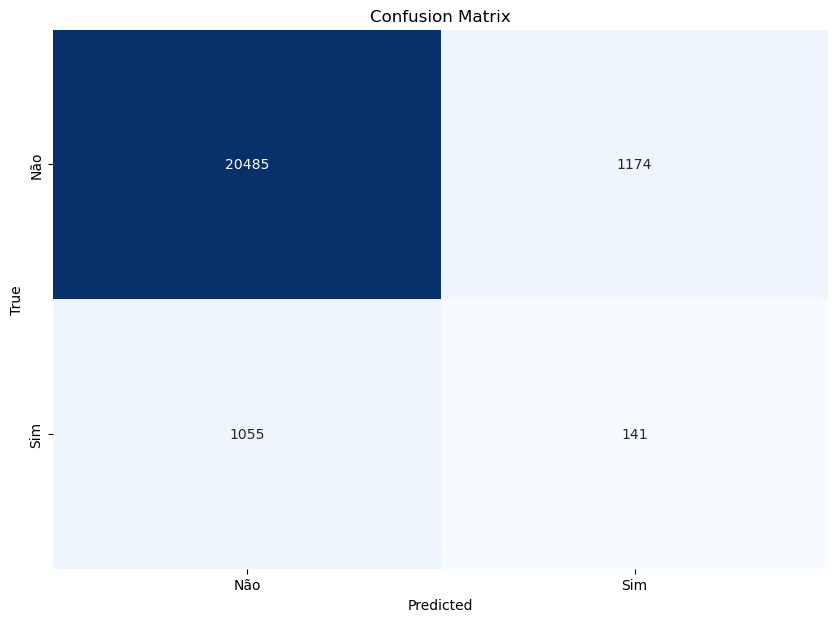

0.9024721067600088


In [17]:
from sklearn.ensemble import RandomForestClassifier


model = RandomForestClassifier(random_state=42)
model.fit(X_resampled, y_resampled)

y_pred = model.predict(X_test)
cm = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(10, 7))
sns.heatmap(
    cm,
    annot=True,
    fmt="d",
    cmap="Blues",
    cbar=False,
    xticklabels=model.classes_,
    yticklabels=model.classes_,
)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.show()

print(model.score(X_test, y_test))
